# Exploring Autoencoders

#### In this notebook I will try to explore Autoencoders. We will start with most simplistic view of a Convolutional Neural Network Layer. We will look at the activations of the layer and look at specifically what it was looking for.
#### We will then move on to build an encoder and decoder network and have each of them run through fixed number of epochs and constant learning rate to understand how does deapth and breadth effects , learning

#### Note : The loss I am using here to guide myself is from the final batch. This is not a consistent loss statistic but since the test parameters are constant , this can be used to understand the behaviour.  Also random initialisation is not seeded. As the valus are around -1,1 the variance will not be much and most result will tend towards same direction

In [1]:
from keras.models import Model
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import *
from keras import backend as K
from keras.layers.advanced_activations import *
from keras import metrics
from keras.applications import *
from keras.preprocessing import image
from keras.initializers import *
from keras import losses
from keras import regularizers
from keras.preprocessing.image import load_img, save_img, img_to_array
import tensorflow as tf

import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import cv2
import time

C:\ProgramData\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [11]:
def denormalise_data(x):
    return np.array( x*127.5 + 127.5, np.uint8)
def normalise_data(x):
    return x/127.5 - 1

def generate_data(data_location):
    batches = os.listdir(data_location)
    for batch in batches:
        data = np.load(data_location+"/"+batch)
        data = normalise_data(data)
        yield data
            
def train(model , epochs , lr , data_location , batch_size = 32):
    optim = Adam(lr)
    model.compile(loss = 'mse' , optimizer = optim)
    losses = []
    t = time.time()
    for epoch in range(epochs):
        for data in generate_data(data_location):
            hist = model.fit(x = data , y = data , batch_size = batch_size , verbose = 1)
            losses.append(hist.history['loss'])
    t = time.time() - t 
    plt.plot(losses)
    plt.show()
    return losses[-1] , t

def visualize(model , layer_name ,sample, size = (10,10)):
    print("Visualising :",layer_name)
    sample = np.array([sample])
    sample = normalise_data(sample)
    x = model.get_layer(layer_name).output
    inp = model.layers[0].output
    out = x
    test = Model(inputs = inp , outputs = out).predict(sample)
    _ , h , w , c = test.shape
    plt.figure(figsize = size)
    it = np.ceil(np.sqrt(c))
    for channel in range(c):
        plt.subplot(it , it , channel+1)
        a = test[0,:,:,channel]
        o = np.interp(a , (a.min(), a.max()), (0, 1)) 
        plt.imshow(o , cmap='gray')
    plt.show()
    print("Looking at the prediction")
    res = model.predict(sample)
    plt.figure(figsize = (10,10))
    plt.subplot(1 , 2 , 1)
    plt.imshow(denormalise_data(sample[0]))
    plt.subplot(1 , 2 , 2)
    plt.imshow(denormalise_data(res[0]))
    

In [3]:
data_location = '../../Dataset/ms_coco_npy'

In [4]:
sample = np.load(data_location+"/"+"batch_1.npy")

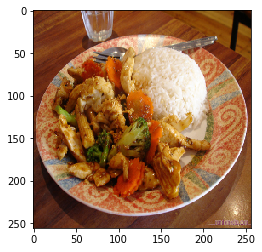

In [5]:
plt.imshow(sample[40])
plt.show()

# 1. Identity Function using CNN
#### We will create the most simplest of Auto encoder with only one convolution filter and see how it behaves
#### We will take 16 convolution and visualize each filter , where we see the activation of each layer
#### Just to note that I havn't exactly put any activation in any of the layer. Because right now it is only learning a mapping function
#### And even a linear kernel could have done the job
PS: I did missed the tanh at the end since my norms are by (-1 , 1) , and non tanh layer would not enforce the range so few values can be off and also it effects the amount of time to minimize loss. So put in the tanh. But again in such simplicity even without tanh it will work

In [116]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=16 , kernel_size=(3,3) , activation=None, padding='same' , name='layer1')(inp)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer1)
model = Model(inputs = inp , outputs = out)
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        (None, 256, 256, 3)       0         
_________________________________________________________________
layer1 (Conv2D)              (None, 256, 256, 16)      448       
_________________________________________________________________
output (Conv2D)              (None, 256, 256, 3)       435       
Total params: 883
Trainable params: 883
Non-trainable params: 0
_________________________________________________________________


Epoch 1/1
511/511 [==============================] - 5s 10ms/step - loss: 0.0955
Epoch 1/1
393/393 [==============================] - 4s 9ms/step - loss: 0.0354
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0163
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0115
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0088
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0076
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0065
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0058
Epoch 1/1
512/512 [==============================] - 5s 10ms/step - loss: 0.0056
Epoch 1/1
512/512 [==============================] - 5s 9ms/step - loss: 0.0054


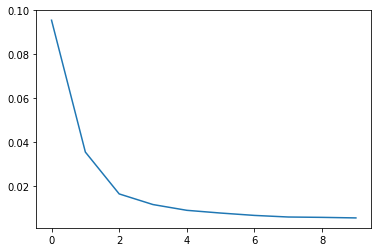

loss : [0.005363567353924736]    time for 1 epoch : 66.734206199646


In [117]:
loss , t = train(model ,1 ,  0.003 ,data_location)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))

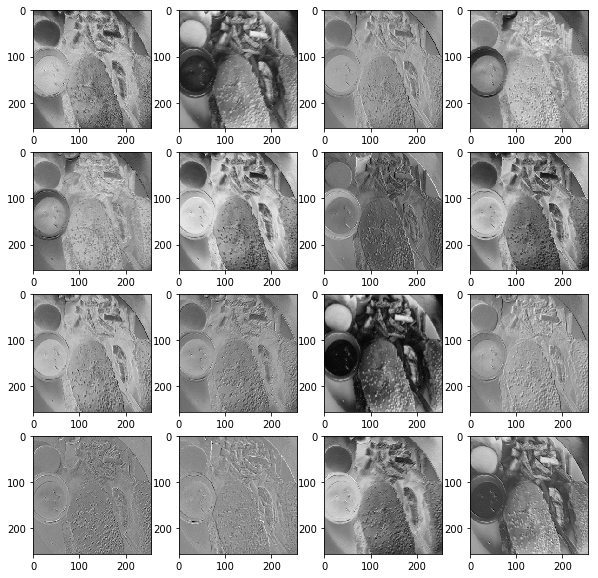

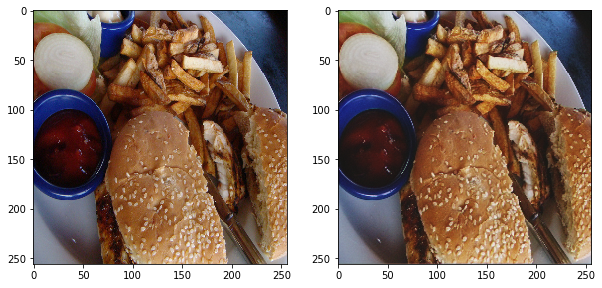

In [121]:
visualize(model , 'layer1' , sample[100])

## 2. Using higher number of filters for identity
#### We can see how the various intermediate layers are capturing information in their own way of highlighting particular section. One of the plot seems to dim the rice part as it's bright and supposedly has a filter to ignore brighter parts. Some other captures the edges while the others , lighting up in between the edges part.

#### Let us increase the number of layers now in the layer 1

#### At filter = 32  **loss : [0.004905381007120013]    time for 1 epoch : 63.110061168670654**
#### At filter = 128 **loss : [0.004127422129386105]    time for 1 epoch : 158.1672341823578** (Note I did had to reduce the batch size , which seem to have affected the generated Image, maybe it got slightly lesser illumination)

#### As it looks like the more filters you add , more the cost of computation but for the same number of epochs , it learns faster

In [133]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=128 , kernel_size=(3,3) , activation=None, padding='same' , name='layer1')(inp)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer1)
model = Model(inputs = inp , outputs = out)
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        (None, 256, 256, 3)       0         
_________________________________________________________________
layer1 (Conv2D)              (None, 256, 256, 128)     3584      
_________________________________________________________________
output (Conv2D)              (None, 256, 256, 3)       3459      
Total params: 7,043
Trainable params: 7,043
Non-trainable params: 0
_________________________________________________________________


Epoch 1/1
511/511 [==============================] - 19s 36ms/step - loss: 0.0230
Epoch 1/1
393/393 [==============================] - 12s 31ms/step - loss: 0.0050
Epoch 1/1
512/512 [==============================] - 14s 27ms/step - loss: 0.0043
Epoch 1/1
512/512 [==============================] - 14s 27ms/step - loss: 0.0044
Epoch 1/1
512/512 [==============================] - 14s 26ms/step - loss: 0.0043
Epoch 1/1
512/512 [==============================] - 14s 27ms/step - loss: 0.0042
Epoch 1/1
512/512 [==============================] - 14s 26ms/step - loss: 0.0040
Epoch 1/1
512/512 [==============================] - 14s 27ms/step - loss: 0.0038
Epoch 1/1
512/512 [==============================] - 14s 27ms/step - loss: 0.0039
Epoch 1/1
512/512 [==============================] - 14s 27ms/step - loss: 0.0041


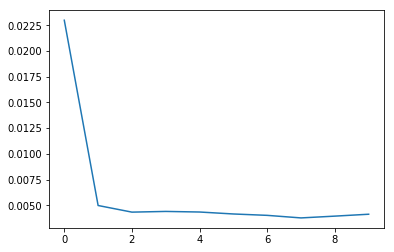

loss : [0.004127422129386105]    time for 1 epoch : 158.1672341823578


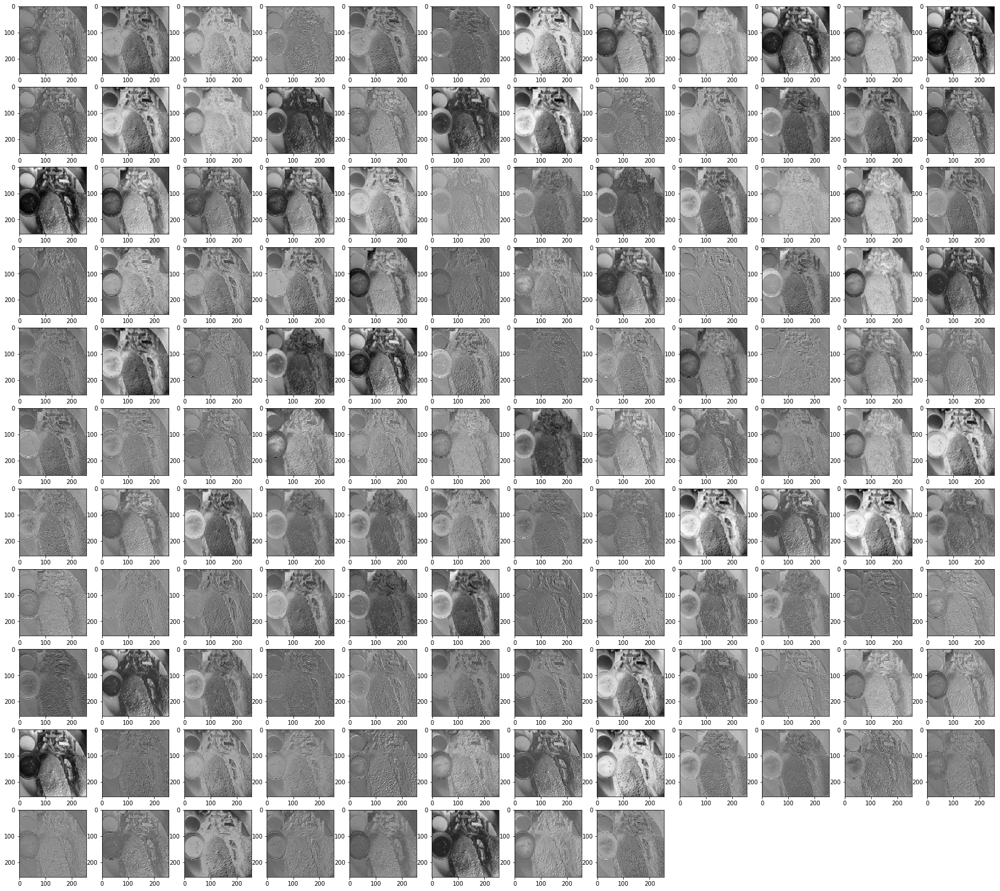

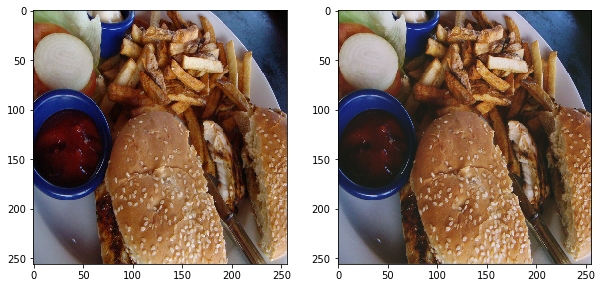

In [135]:
loss , t = train(model ,1 ,  0.003 ,data_location , batch_size= 16)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))
visualize(model , 'layer1' , sample[100] , size = (30,30))

## 3. Introducing Depth 
#### So let's try including depth. For now we will keep bredth of the layer i.e number of filter consistent throughout depth and we will see how it affects the training time and performance.

#### At 32 ==> 32 **loss : [0.00402224475692492]    time for 1 epoch : 107.72452330589294** (This was faster than large number of filters , even though number of paramters to be trained was higher. )
#### At 32 ==> 16 **loss : [0.004503197444137186]    time for 1 epoch : 89.04146838188171** (Yes it was faster , but compressing the information was not a good idea, it increased the loss, so don't decrease the information from the filters unless necessary)
#### At 32 ==> 128 **loss : [0.0037562793659162708]    time for 1 epoch : 210.21594738960266** Time was drastically increased and the gain in loss decrease is minimal. Keeping the layers consistent makes more sense.

#### But in an AutoEncoder the idea is to have the data represent in lower dimensional space than the original given. That means the original architecture of 32 ==> 32 is what we actually want but we need to compress the information in between. Compression leads to increased loss. But we will not work on the compressed information directly we will try to expand it. If all this sounds more like PCA. Then ya autoencoders are PCA. If you turn the conv blocks into matrix and do the standard matmul ops with the weight , guess it will be a standard PCA for finding principal components. Only in this case the way we are considering the dimension is skewed since we lack understanding of extremely higher dimensional space. And the principal components here in this case capture informations like edges , luminance etc.


In [160]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=32 , kernel_size=(3,3) , activation=None, padding='same' , name='layer1')(inp)
layer2 = Conv2D(filters=128 , kernel_size=(3,3) , activation=None, padding='same' , name='layer2')(layer1)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer2)
model = Model(inputs = inp , outputs = out)
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_28 (InputLayer)        (None, 256, 256, 3)       0         
_________________________________________________________________
layer1 (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
layer2 (Conv2D)              (None, 256, 256, 128)     36992     
_________________________________________________________________
output (Conv2D)              (None, 256, 256, 3)       3459      
Total params: 41,347
Trainable params: 41,347
Non-trainable params: 0
_________________________________________________________________


Epoch 1/1
511/511 [==============================] - 21s 41ms/step - loss: 0.0550
Epoch 1/1
393/393 [==============================] - 15s 39ms/step - loss: 0.0067
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0048
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0048
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0045
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0044
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0041
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0040
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0040
Epoch 1/1
512/512 [==============================] - 20s 39ms/step - loss: 0.0047


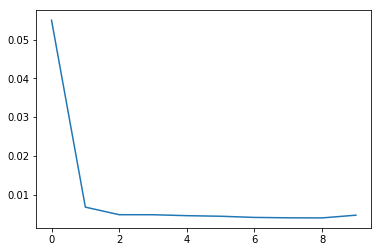

loss : [0.0046603971713921055]    time for 1 epoch : 216.74476957321167


In [161]:
loss , t = train(model ,1 ,  0.003 ,data_location , batch_size= 16)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))

################## LAYER 1 #########################


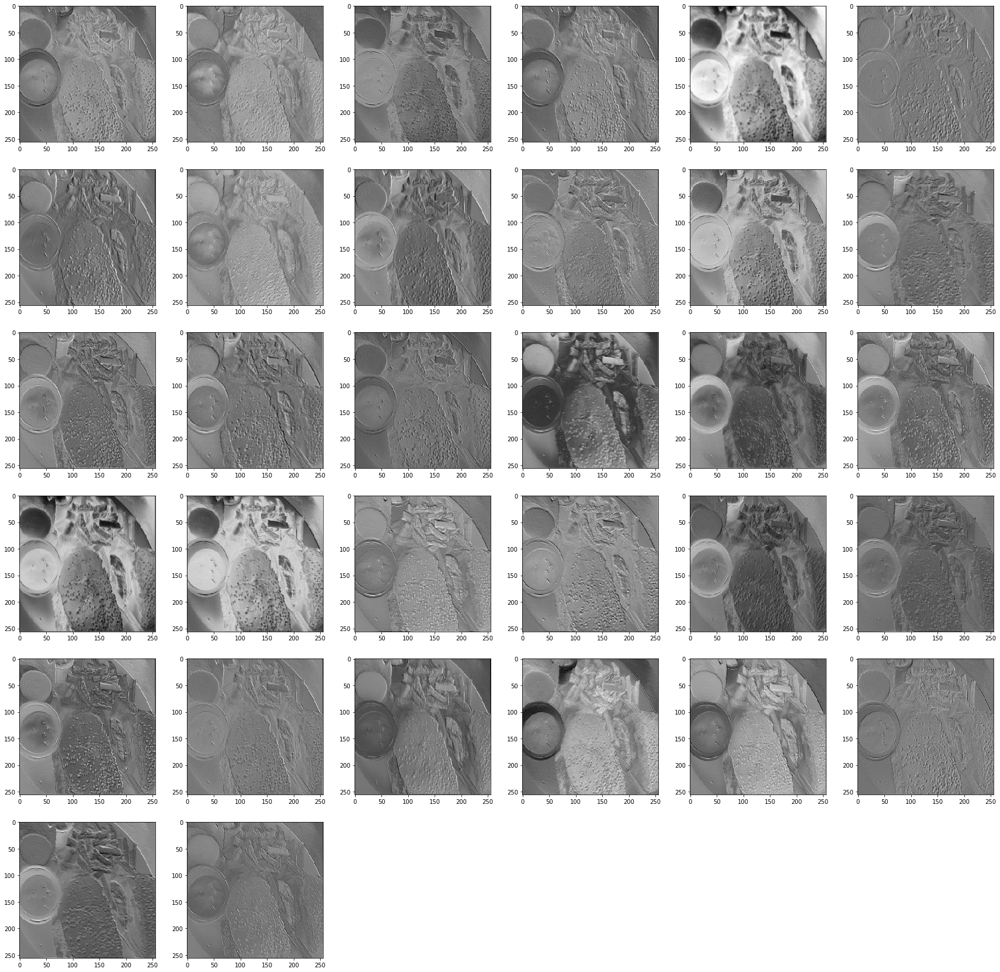

################## LAYER 2 #########################


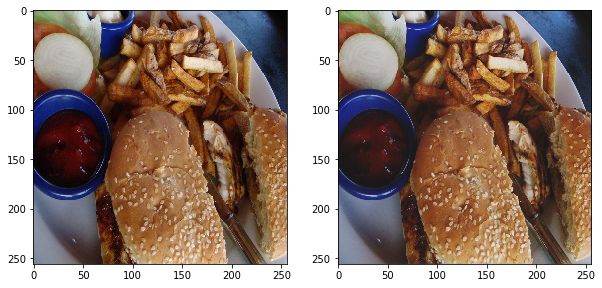

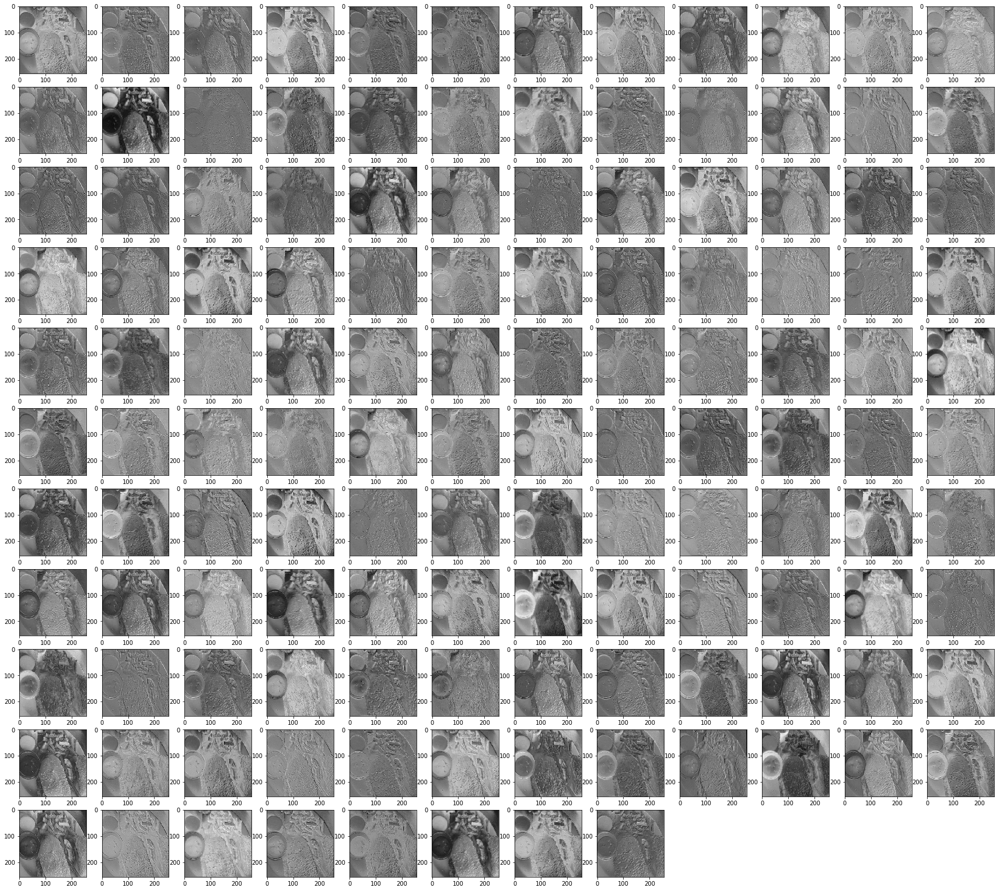

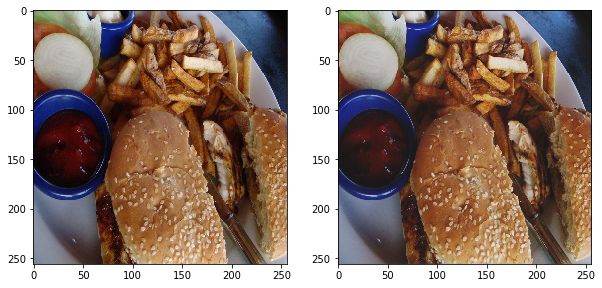

In [162]:
print("################## LAYER 1 #########################")
visualize(model , 'layer1' , sample[100] , size = (30 , 30))
print("################## LAYER 2 #########################")
visualize(model , 'layer2' , sample[100] , size = (30 , 30))

## 4. Autoencoder with identity (No loss of spatial information)
#### Here we construct the Autoencoder. The autoencoder here will only be transforming the layers into feature representation expanding , contracting and re-expanding them to finally reconstruct the Image. We will also try with expading -> expand -> contract. As it's already see sudden contraction makes for inconsistent learning. We will avoid that

#### At 32 ==> 16 ==> 32 **loss : [0.004550919235043693]    time for 1 epoch : 112.62125587463379** looks like it completely relies on the bottle neck. Though we know now why we need the decoder and the encoder to be symmetric

#### At 32 ==> 8 ==> 32 **loss : [0.004640000450308435]    time for 1 epoch : 102.47580122947693** The result on this one is not consistent. But we can safely assume the loss is higher. 

#### At 32 ==> 64 ==> 32 **loss : [0.004311515513109043]    time for 1 epoch : 161.78558778762817** Well Guess I am resorting to progressively expanding the information. It is time taking. But worth it I suppose. Also make sense. Since you cannot initialise a large number of filter at the begining , you initialise a smaller number loose a bit of the spatial information by reducing dimension and then again try to reconstuct it back up.

In [165]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=32 , kernel_size=(3,3) , activation=None, padding='same' , name='layer1')(inp)
layer2 = Conv2D(filters=64 , kernel_size=(3,3) , activation=None, padding='same' , name='layer2')(layer1)
layer3 = Conv2D(filters=32 , kernel_size=(3,3) , activation=None, padding='same' , name='layer3')(layer2)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer3)
model = Model(inputs = inp , outputs = out)
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_30 (InputLayer)        (None, 256, 256, 3)       0         
_________________________________________________________________
layer1 (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
layer2 (Conv2D)              (None, 256, 256, 64)      18496     
_________________________________________________________________
layer3 (Conv2D)              (None, 256, 256, 32)      18464     
_________________________________________________________________
output (Conv2D)              (None, 256, 256, 3)       867       
Total params: 38,723
Trainable params: 38,723
Non-trainable params: 0
_________________________________________________________________


Epoch 1/1
511/511 [==============================] - 16s 32ms/step - loss: 0.1145
Epoch 1/1
393/393 [==============================] - 12s 30ms/step - loss: 0.0162
Epoch 1/1
512/512 [==============================] - 16s 30ms/step - loss: 0.0075
Epoch 1/1
512/512 [==============================] - 16s 31ms/step - loss: 0.0061
Epoch 1/1
512/512 [==============================] - 16s 31ms/step - loss: 0.0054
Epoch 1/1
512/512 [==============================] - 16s 31ms/step - loss: 0.0051
Epoch 1/1
512/512 [==============================] - 16s 31ms/step - loss: 0.0047
Epoch 1/1
512/512 [==============================] - 16s 30ms/step - loss: 0.0045
Epoch 1/1
512/512 [==============================] - 16s 30ms/step - loss: 0.0045
Epoch 1/1
512/512 [==============================] - 16s 30ms/step - loss: 0.0043


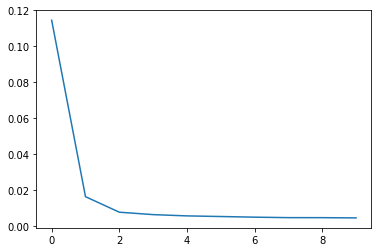

loss : [0.004311515513109043]    time for 1 epoch : 161.78558778762817


In [166]:
loss , t = train(model ,1 ,  0.003 ,data_location , batch_size= 32)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))

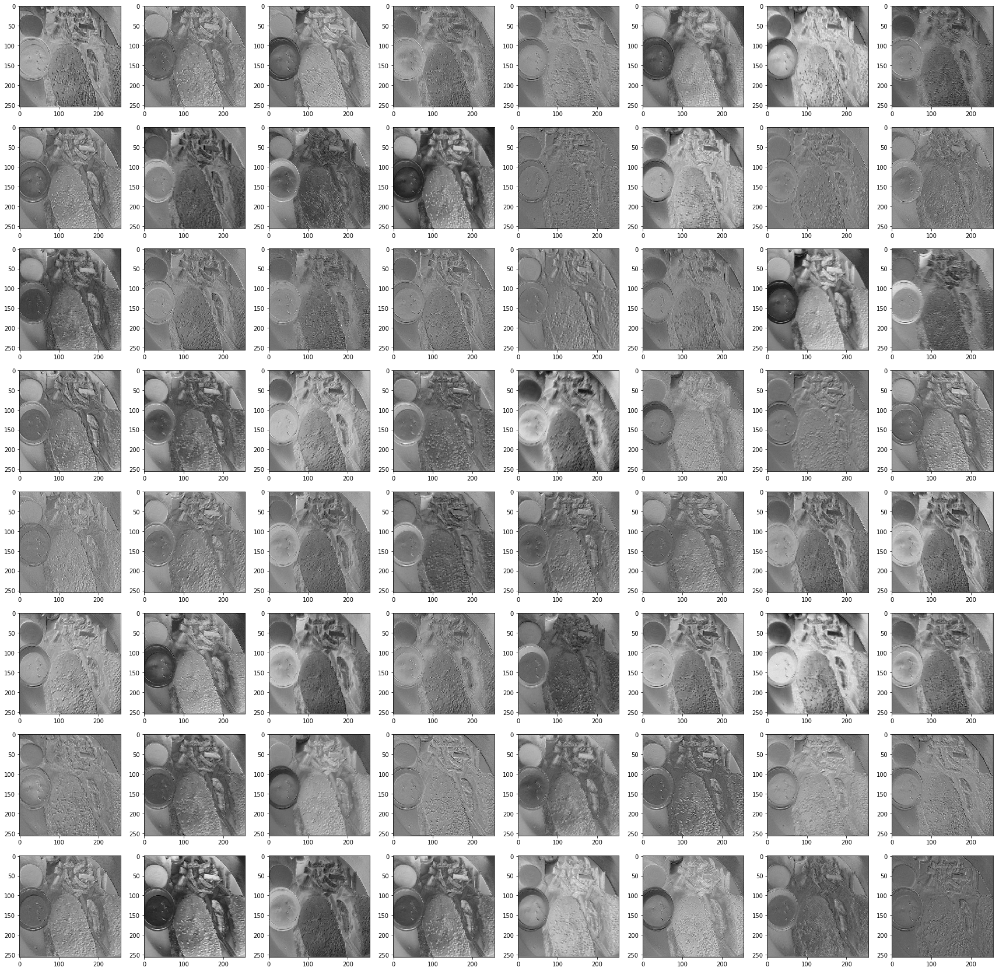

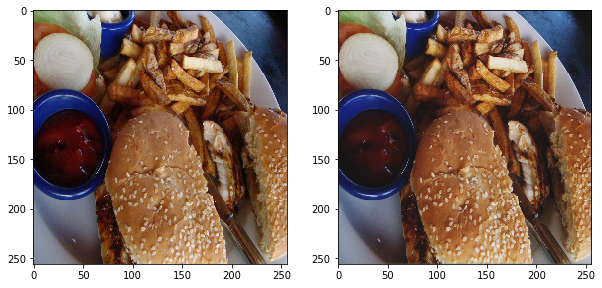

In [167]:
visualize(model , 'layer2' , sample[100] , size = (30 , 30))

## 5. Proto-AutoEncoder with loss of Spatial Information (Pooling or By Stride)
#### Just so that you know. MaxPooling does not have a reverse operation. I mean you can do Fractional Strided Convolution in reverse of Convolution with strides, or Deconvolution. Some say they are different. I will resort to keras way of doing it.
#### So what do you do. Well we can always go on experimenting, but I will avoid the MaxPool discontinuois operation. Conv with strides is what i will use. You can also use (1,1) filter to create a feature extractor. Ya that's what the DeepLearning.ai course seems call it in the Inception Lecture, it's been a year I have followed up on those lectures.

In [169]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=32 , kernel_size=(3,3) , activation=None, padding='same' , name='layer1')(inp)
layer2 = Conv2D(filters=64 , kernel_size=(3,3) , strides=(2,2), activation=None, padding='same' , name='layer2')(layer1)
layer3 = Conv2DTranspose(filters=32 , kernel_size=(3,3) , strides=(2,2), activation=None, padding='same' , name='layer3')(layer2)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer3)
model = Model(inputs = inp , outputs = out)
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_31 (InputLayer)        (None, 256, 256, 3)       0         
_________________________________________________________________
layer1 (Conv2D)              (None, 256, 256, 32)      896       
_________________________________________________________________
layer2 (Conv2D)              (None, 128, 128, 64)      18496     
_________________________________________________________________
layer3 (Conv2DTranspose)     (None, 256, 256, 32)      18464     
_________________________________________________________________
output (Conv2D)              (None, 256, 256, 3)       867       
Total params: 38,723
Trainable params: 38,723
Non-trainable params: 0
_________________________________________________________________


#### In case you are wondering what happened. Deconvolution is the reverse process of Conv. So in short they have almost same number of parameters because deconv does what backprop on conv does but while in feed forward mode. [Great animations on convolution](https://github.com/vdumoulin/conv_arithmetic). This should help

Epoch 1/1
511/511 [==============================] - 16s 31ms/step - loss: 0.0683
Epoch 1/1
393/393 [==============================] - 10s 26ms/step - loss: 0.0168
Epoch 1/1
512/512 [==============================] - 13s 26ms/step - loss: 0.0103
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0079
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0070
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0061
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0052
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0048
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0048
Epoch 1/1
512/512 [==============================] - 13s 25ms/step - loss: 0.0046


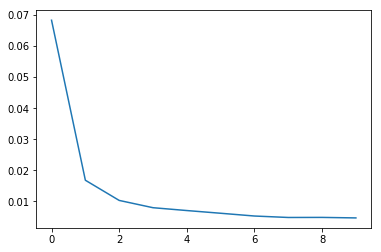

loss : [0.004636613943148404]    time for 1 epoch : 142.74754405021667


In [170]:
loss , t = train(model ,1 ,  0.003 ,data_location , batch_size= 32)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))

looking at the Convolution Bottlneck


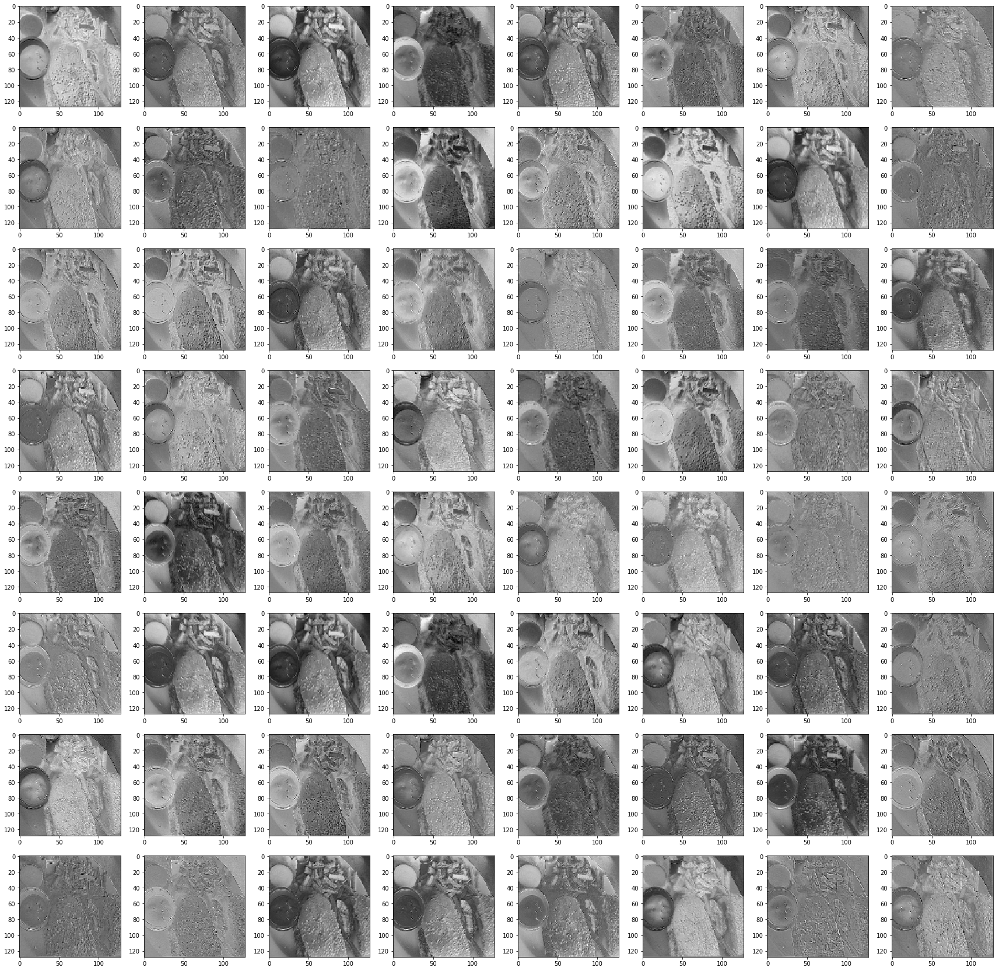

looking at the Deconvolution block


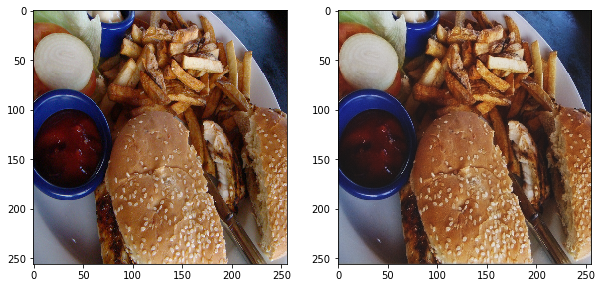

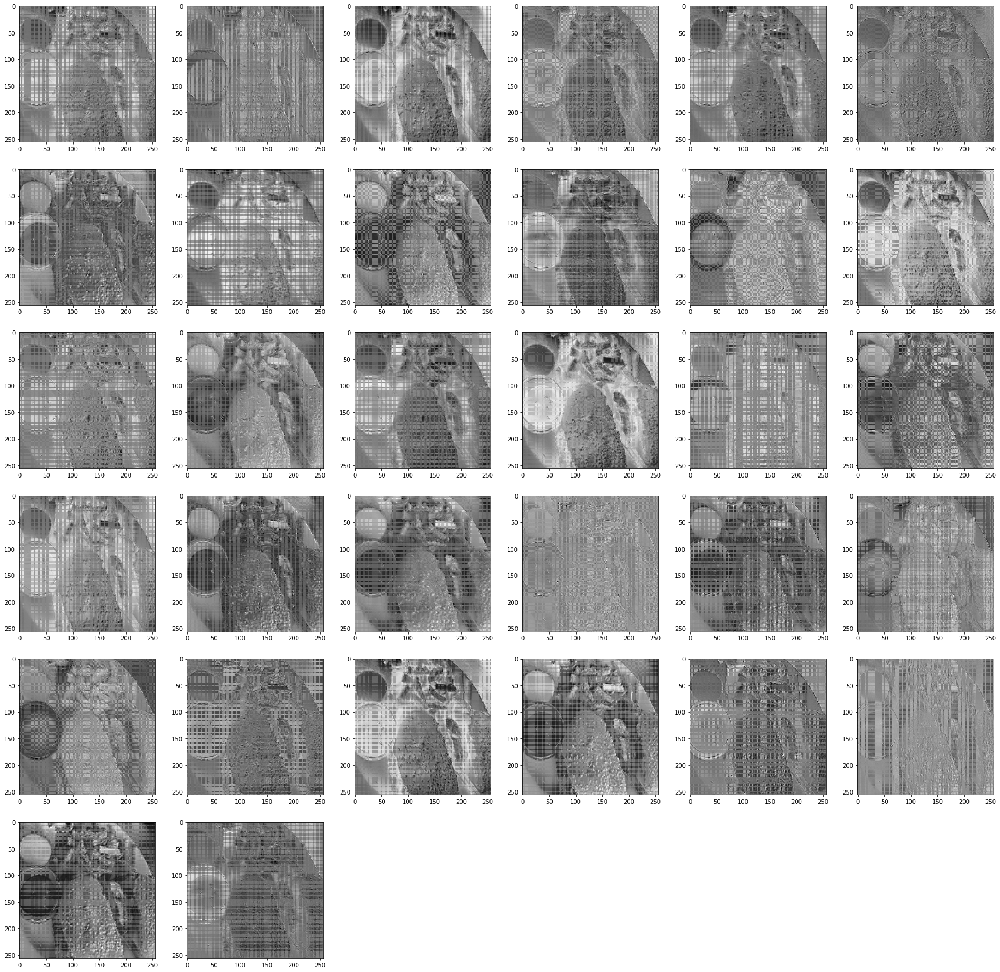

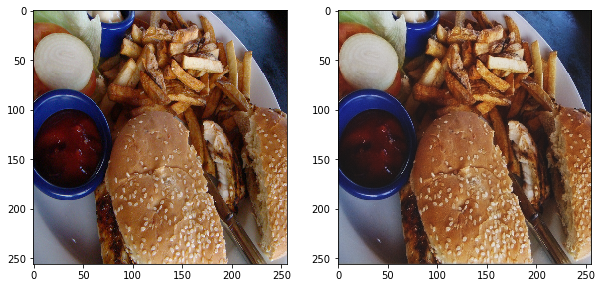

In [171]:
print("looking at the Convolution Bottlneck")
visualize(model , 'layer2' , sample[100] , size = (30 , 30))
print("looking at the Deconvolution block")
visualize(model , 'layer3' , sample[100] , size = (30 , 30))

#### If you can see checkerboard on the Deconvolution filter Result Ya that is the infamous checkerboard artifact that you get from the Deconv layers. Because Deconv let's a portion of the image space empty. These are adribut changes and appears as squared. The last output layer actually fixes this. If we would have used a Deconv for final layer then we may have seen this in our final layer + our loss have been much higher

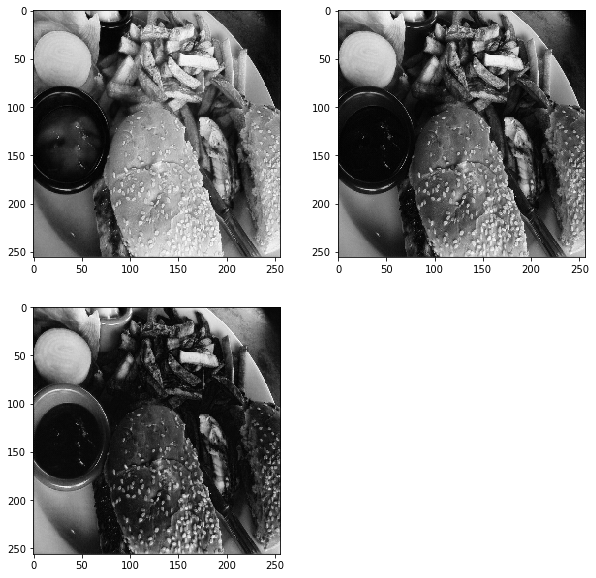

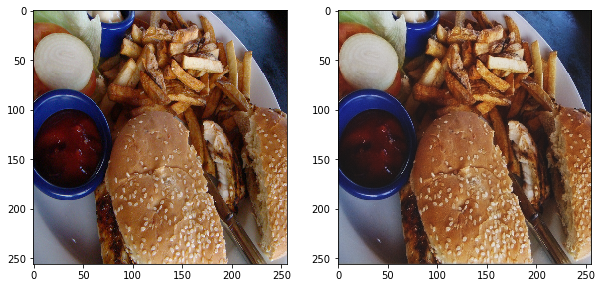

In [173]:
visualize(model , 'output' , sample[100] , size = (10 , 10)) ## Looking at the output layer

#### Checkerboard artifact is fixed. So ya lesson learned use Conv after Deconv

## 6. Build the AutoEncoder Already !!
#### There are a lot of configuration to explore and that much exploration would probably break my browser. But what is more important here is right now we are not killing of the information. When I say kill off i mean using Pool layers to decrease the size. Which will allow to decrease the size of the convolution block and force it to only contain important information
#### In the very next one we built a fully convolution Autoencoder , that will have a flattened layer bottleneck. And much of the information loss will be present then. We also have not used activations that can turn our linear autoencoder into a non linear autoencoder. That means the transformation will not rely on only the linear transformation anymore.  But while construction we knpw a few things now

* Symmetric Decoder and Encoder , since you want the same information
* Deapth increases , loss decreases faster.
* You need more bigger representation in the starting if you intend to go more deeper. Any adrupt change will increase the loss 
* Since you don't want adrupt change , you want smaller bottleneck , so you must go deeper.
* Conv after Deconv
* Expand current information in much higher space i.e increase breadth wit deapth but loose spatial information
* Continuous or Discontinuous ops for reducing size
* We need to included non-linearity in such cases. Why ? Because Neural nets are universal function approximators. So they need to be non linear in some way. You can try e^x or something else. But ReLu or Sigmoid or Tanh are proven methods

#### We will now create a flat representation and try to infer from that reprsentation.
#### Flat i.e vectorised representation is what we can then later use to do plotting and visualization of the objects
#### Let's see how much we can compress the entire image space

In [8]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=32 , kernel_size=(3,3) , strides = (2,2) , activation='relu', padding='same' , name='layer1' , )(inp)
layer2 = Conv2D(filters=64 , kernel_size=(3,3) , strides=(2,2), activation='relu', padding='same' , name='layer2' , )(layer1)
layer3 = Conv2D(filters=128 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name='layer3' , )(layer2)
layer4 = Conv2D(filters = 256 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name='layer4' , )(layer3)
layer5 = Conv2D(filters = 512 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name = 'layer5' , )(layer4)
layer6 = Conv2D(filters = 1024 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name = 'layer6' , )(layer5)
layer7 = AveragePooling2D()(layer6) ## 4096 feature representation

## The layer 7 can now be used for any kind of visualization, The official docs of Keras mentions using t-SNE. 
## We have also avoid the sparsity constraints , which will avoid all the nodes giving high output i.e feature representation
## will be more robust
############################# Decoder network ################################

layer8 = Conv2DTranspose(filters = 1024 , kernel_size =(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer8' , )(layer7)
layer8 = Concatenate()([layer8 , layer6])
layer9 = Conv2DTranspose(filters = 512 , kernel_size =(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer9' , )(layer8)
layer9 = Concatenate()([layer9 , layer5])
layer10 = Conv2DTranspose(filters = 256 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer10' , )(layer9)
layer10 = Concatenate()([layer10 , layer4])
layer11 = Conv2DTranspose(filters = 128 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer11' , )(layer10)
layer11 = Concatenate()([layer11 , layer3])
layer12 = Conv2DTranspose(filters = 64 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer12' , )(layer11)
layer12 = Concatenate()([layer12 , layer2])
layer13 = Conv2DTranspose(filters = 32 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer13' , )(layer12)
layer14 = Conv2DTranspose(filters = 32 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer14' , )(layer13)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer14)
model = Model(inputs = inp , outputs = out)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
layer1 (Conv2D)                 (None, 128, 128, 32) 896         input_3[0][0]                    
__________________________________________________________________________________________________
layer2 (Conv2D)                 (None, 64, 64, 64)   18496       layer1[0][0]                     
__________________________________________________________________________________________________
layer3 (Conv2D)                 (None, 32, 32, 128)  73856       layer2[0][0]                     
__________________________________________________________________________________________________
layer4 (Co

Epoch 1/1
511/511 [==============================] - 63s 124ms/step - loss: 0.0064
Epoch 1/1
393/393 [==============================] - 47s 119ms/step - loss: 0.0038
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0041
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0039
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0040
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0043
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0032
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0028
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0026
Epoch 1/1
512/512 [==============================] - 61s 119ms/step - loss: 0.0034


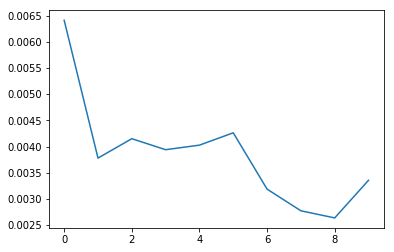

loss : [0.0033558822369741392]    time for 1 epoch : 613.1365303993225


In [10]:
loss , t = train(model , 1 ,  0.003 ,data_location , batch_size= 4)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))

#### This is where you may find using a activation helpful. the ReLU activation makes the training losses smaller compared to not using any activation. The loss without ReLU is around 1.300+ but with relu this changes and the loss starts at 0.31 . Big difference

#### Also note that I had to change , batch size + learning rate this time. Reducing both of them made it better.

#### Also to be considered is that our image size is big and our data size or time invested in training is just not enough,
#### Maybe we can try what Bengio says [Use patches](https://www.quora.com/How-large-should-be-the-data-set-for-training-a-Deep-auto-encoder)

#### Occasionally I try the U-net architecture just to see whether it is any helpful. back during my intern i did obseved u-net working great for denoising 

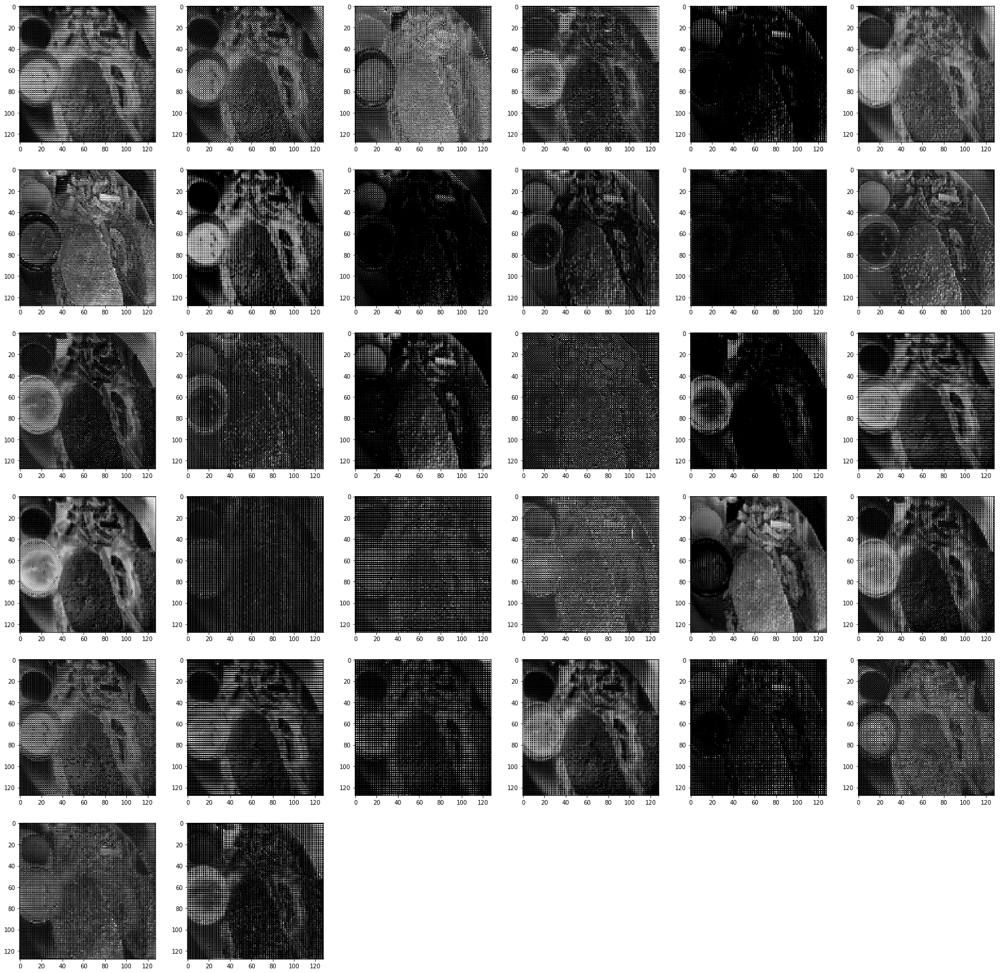

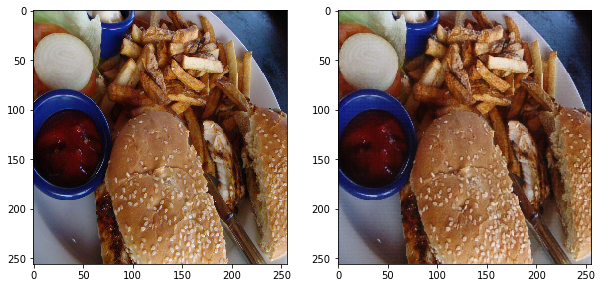

In [24]:
## Output when using 32 ==> 64 ==> 32 
visualize(model , 'layer13' , sample[100] , size = (30 , 30))
## You can look at how the original data is reconstruced. With each filter trying to recreate what th early layers captures.

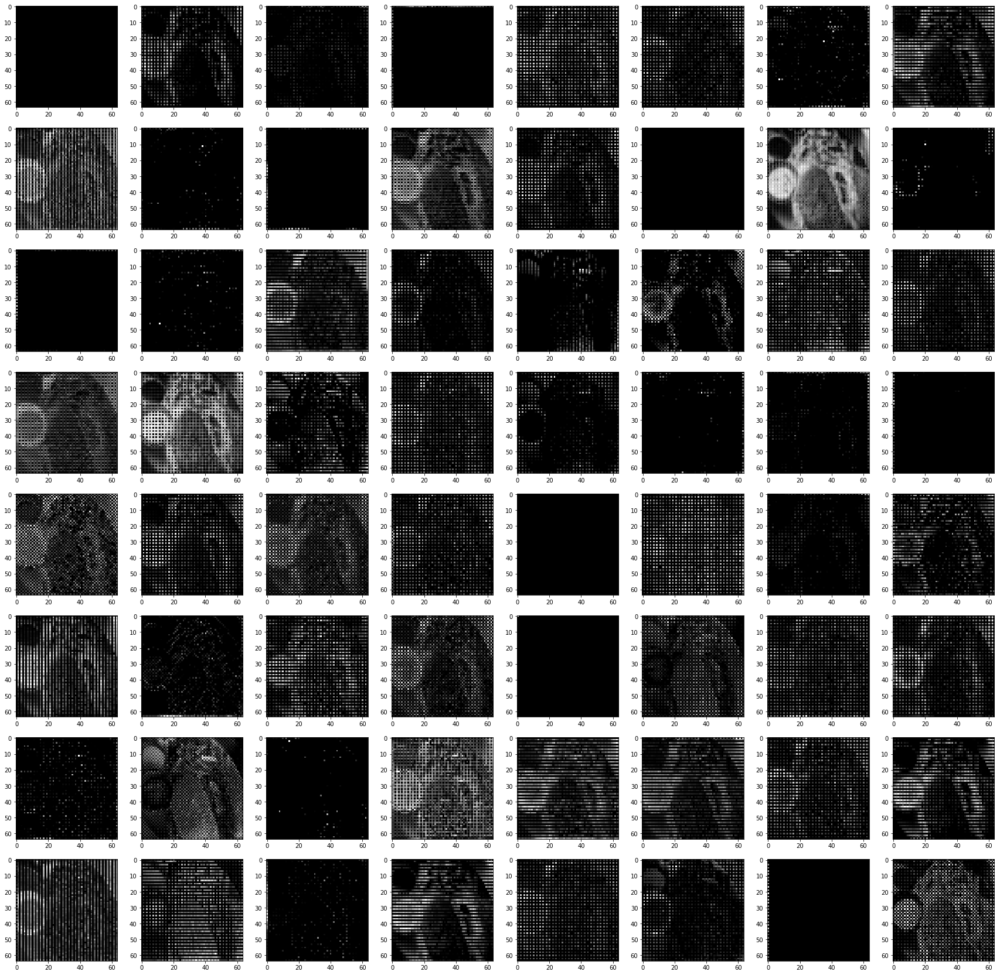

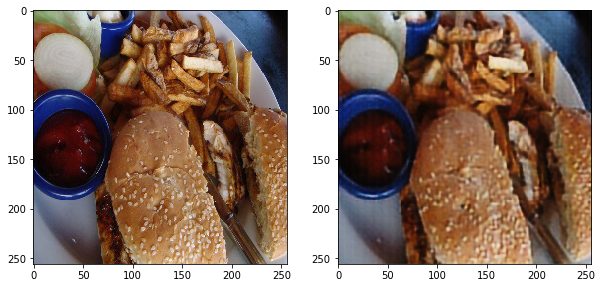

In [27]:
## Output when using 32 ==> 64 ==> 128 ==> 128 ==> 64 ==> 32 
visualize(model , 'layer12' , sample[100] , size = (30 , 30))
## You can look at how the original data is reconstruced. With each filter trying to recreate what th early layers captures.

Visualising : layer11


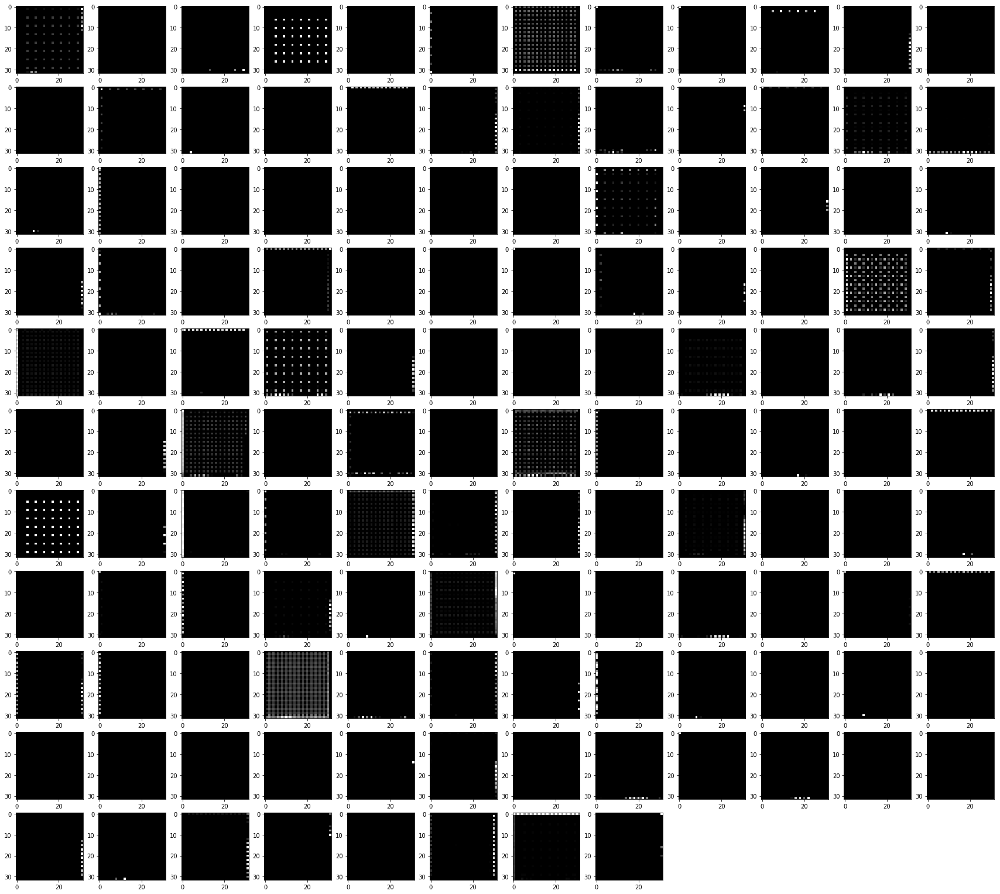

Looking at the prediction
Visualising : layer12


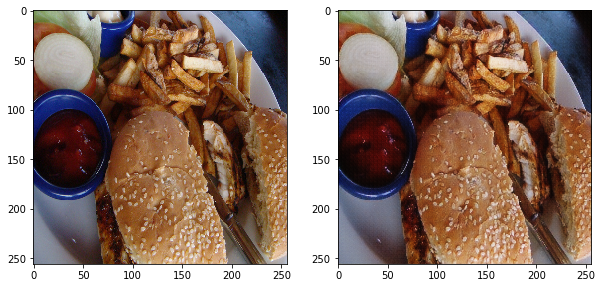

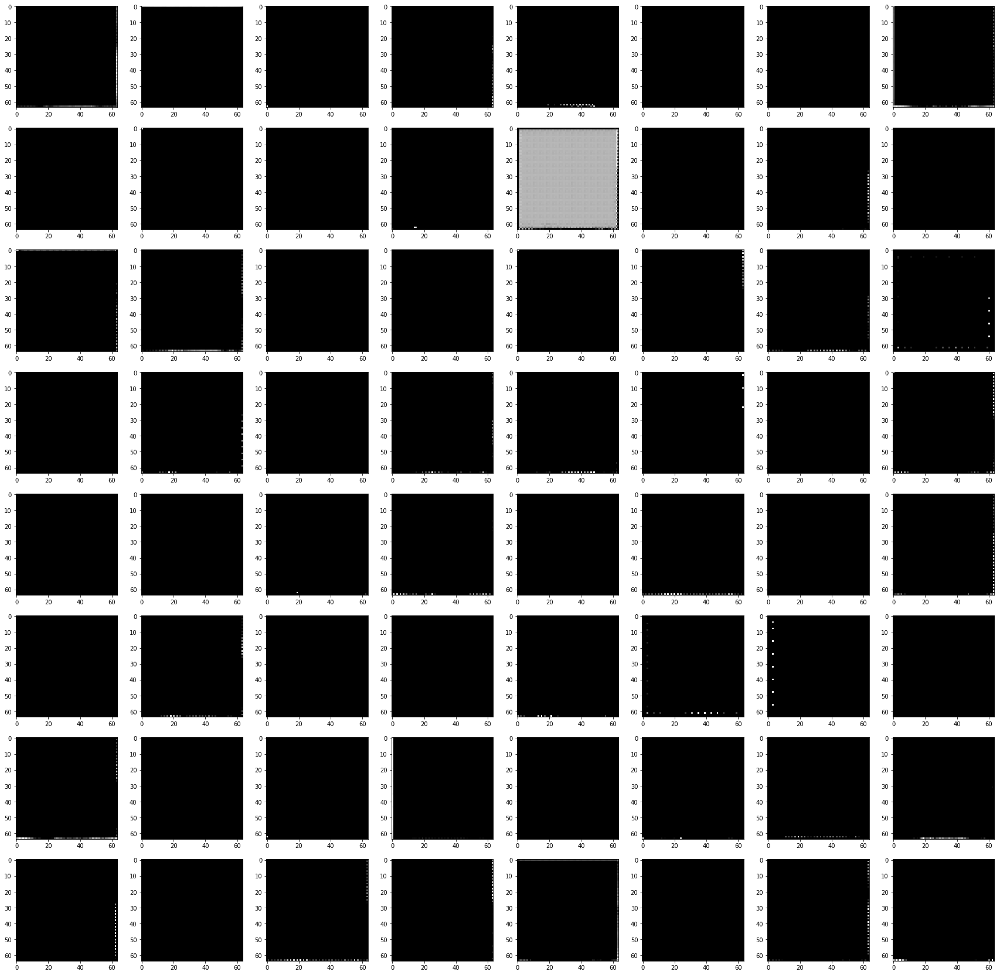

Looking at the prediction
Visualising : layer13


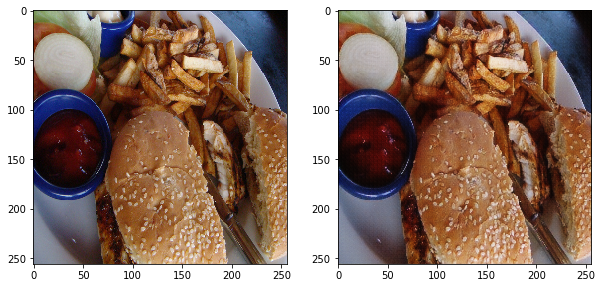

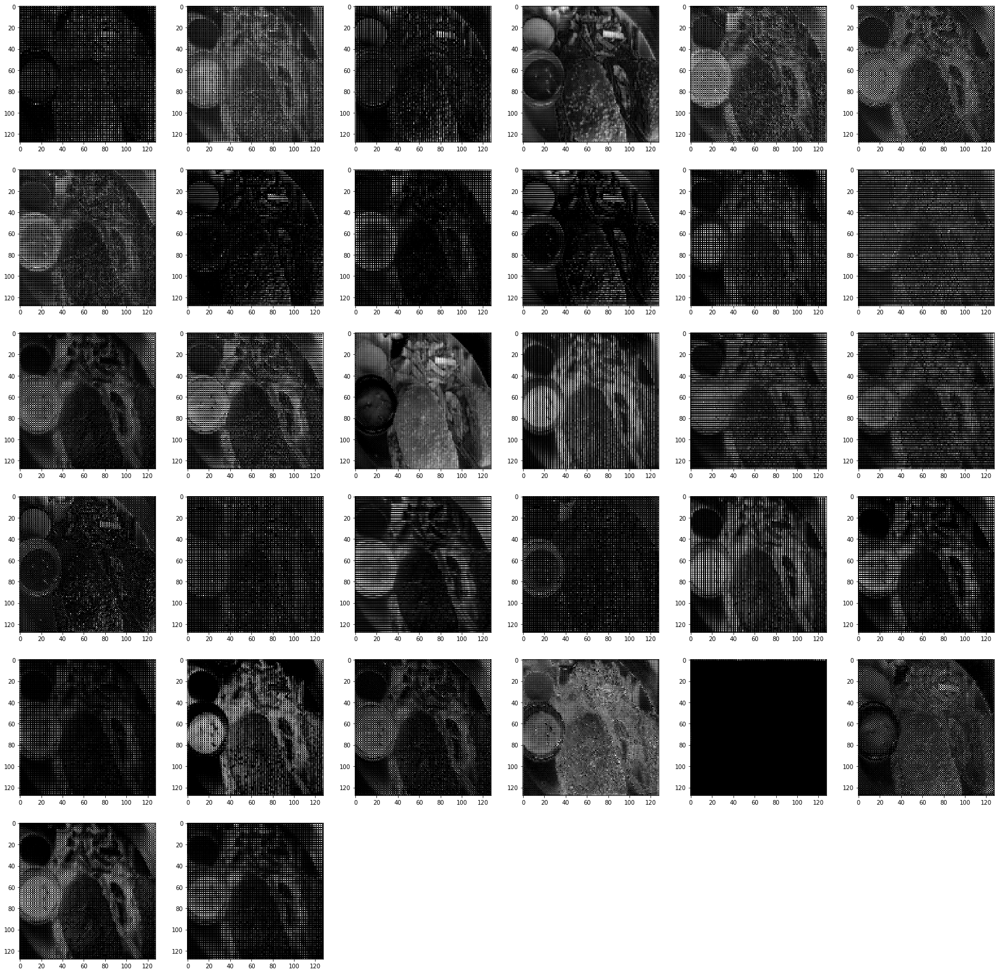

Looking at the prediction


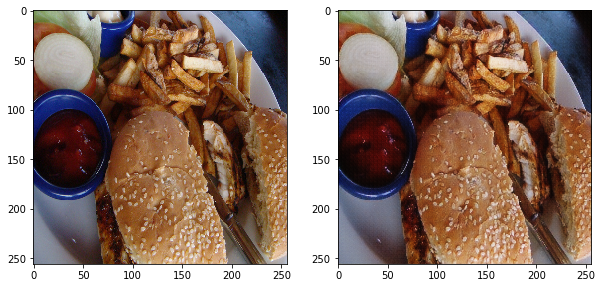

In [12]:
## Full architecture
visualize(model , 'layer11' , sample[100] , size = (30 , 30))
visualize(model , 'layer12' , sample[100] , size = (30 , 30))
visualize(model , 'layer13' , sample[100] , size = (30 , 30))
## You can look at how the original data is reconstruced. With each filter trying to recreate what th early layers captures.

#### Just so that you know . We took some GIANT LEAPS with our autoencoder architecture. First thing our hidden latent vector is now of 1024 * 2 * 2 variable size. Which can be reduced of maybe furthur down. Computational power restraictions !! The latent vector can then be used by some other visualization method. We won't try that here since we don't have any class labels to properly visualise. Also we took giant leap with our model to turn it into a U-Net Autoencoder. Those came to picture with Semantic Segmentation problems. And as you see they work great. Also we have our compressed representation. Though it's bit of a cheating , if you ask me. Let's see can it remove added white noise. We will keep the model the same. And now first test without training and then resort to training.

#### PS: Also I have absolutely no clue what those activations mean in the very early and mid layers. Looks like they have absolutely no usefull activation and information. Suppose much of it was achieved with skip connection. So maybe we can try and minimise our Skip connection and see again how it performs

## 7. We donot follow U-net , and only use skips in the very deep layers

In [13]:
## 
inp = Input(shape = (256 , 256 , 3))
layer1 = Conv2D(filters=32 , kernel_size=(3,3) , strides = (2,2) , activation='relu', padding='same' , name='layer1' , )(inp)
layer2 = Conv2D(filters=64 , kernel_size=(3,3) , strides=(2,2), activation='relu', padding='same' , name='layer2' , )(layer1)
layer3 = Conv2D(filters=128 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name='layer3' , )(layer2)
layer4 = Conv2D(filters = 256 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name='layer4' , )(layer3)
layer5 = Conv2D(filters = 512 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name = 'layer5' , )(layer4)
layer6 = Conv2D(filters = 1024 , kernel_size=(3,3) , strides=(2,2) , activation='relu' , padding='same' , name = 'layer6' , )(layer5)
layer7 = AveragePooling2D()(layer6) ## 4096 feature representation

## The layer 7 can now be used for any kind of visualization, The official docs of Keras mentions using t-SNE. 
## We have also avoid the sparsity constraints , which will avoid all the nodes giving high output i.e feature representation
## will be more robust
############################# Decoder network ################################

layer8 = Conv2DTranspose(filters = 1024 , kernel_size =(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer8' , )(layer7)
layer8 = Concatenate()([layer8 , layer6])
layer9 = Conv2DTranspose(filters = 512 , kernel_size =(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer9' , )(layer8)
layer9 = Concatenate()([layer9 , layer5])
layer10 = Conv2DTranspose(filters = 256 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer10' , )(layer9)
layer10 = Concatenate()([layer10 , layer4])
layer11 = Conv2DTranspose(filters = 128 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer11' , )(layer10)
# layer11 = Concatenate()([layer11 , layer3])
layer12 = Conv2DTranspose(filters = 64 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer12' , )(layer11)
# layer12 = Concatenate()([layer12 , layer2])
layer13 = Conv2DTranspose(filters = 32 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer13' , )(layer12)
layer14 = Conv2DTranspose(filters = 32 , kernel_size=(3,3) , strides = (2,2) , activation='relu' , padding='same' , name='layer14' , )(layer13)
out = Conv2D(filters = 3 , kernel_size=(3,3) , activation='tanh' , padding='same' , name = 'output')(layer14)
model = Model(inputs = inp , outputs = out)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
layer1 (Conv2D)                 (None, 128, 128, 32) 896         input_4[0][0]                    
__________________________________________________________________________________________________
layer2 (Conv2D)                 (None, 64, 64, 64)   18496       layer1[0][0]                     
__________________________________________________________________________________________________
layer3 (Conv2D)                 (None, 32, 32, 128)  73856       layer2[0][0]                     
__________________________________________________________________________________________________
layer4 (Co

Epoch 1/1
511/511 [==============================] - 63s 123ms/step - loss: 0.0317
Epoch 1/1
393/393 [==============================] - 46s 118ms/step - loss: 0.0280
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0275
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0290
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0257
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0268
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0262
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0231
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0232
Epoch 1/1
512/512 [==============================] - 60s 117ms/step - loss: 0.0240
Epoch 1/1
511/511 [==============================] - 60s 117ms/step - loss: 0.0235
Epoch 1/1
393/393 [==============================] - 46s 118ms/step - loss: 0.0222
Epoc

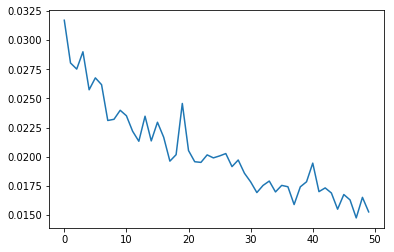

loss : [0.015266034475644119]    time for 1 epoch : 3023.8681807518005


In [15]:
loss , t = train(model , 5 ,  0.003 ,data_location , batch_size= 4)
print('loss : {}    time for 1 epoch : {}'.format(loss, t))

Visualising : layer11


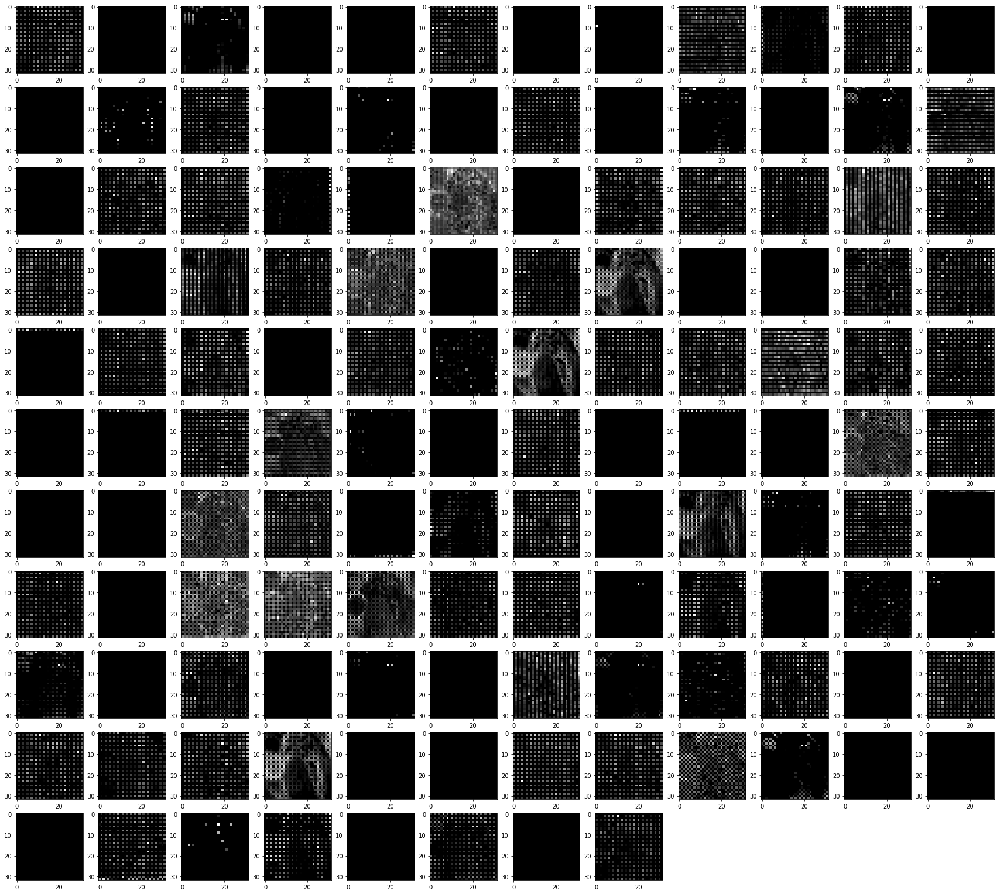

Looking at the prediction


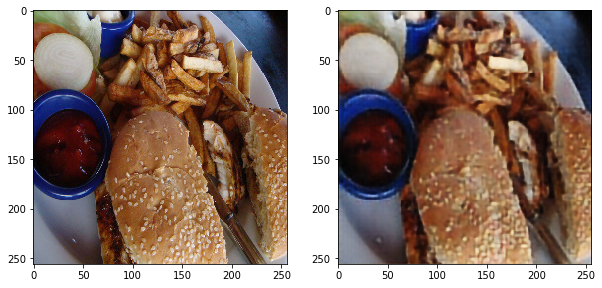

In [16]:
visualize(model , 'layer11' , sample[100] , size = (30 , 30))

#### And the early layers did learn something this time. Though the image quality is not same. But ya it's a great reconstruction. Only because of the skip connection I suppose. We can though try one thing. Regulate how much of the prior information was used to reconstruct the image. i.e multiply a weight to the skip connection so that not too much information from prior to downgrade is taken into account.

#### function below [Credits](https://stackoverflow.com/questions/22937589/how-to-add-noise-gaussian-salt-and-pepper-etc-to-image-in-python-with-opencv)

In [49]:
def noisy(noise_typ,image):
    if noise_typ == "gauss":
        row,col,ch= image.shape
        mean = 0
        var = 0.1
        sigma = var**0.5
        gauss = np.random.normal(mean,sigma,(row,col,ch))
        gauss = gauss.reshape(row,col,ch)
        noisy = image + gauss
        return noisy
    elif noise_typ == "s&p":
        row,col,ch = image.shape
        s_vs_p = 0.5
        amount = 0.004 ### Change this and experiment
        out = np.copy(image)
        # Salt mode
        num_salt = np.ceil(amount * image.size * s_vs_p)
        coords = [np.random.randint(0, i - 1, int(num_salt))
              for i in image.shape]
        out[coords] = 1

        # Pepper mode
        num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
        coords = [np.random.randint(0, i - 1, int(num_pepper))
              for i in image.shape]
        out[coords] = 0
        return out
    elif noise_typ == "poisson":
        vals = len(np.unique(image))
        vals = 2 ** np.ceil(np.log2(vals))
        noisy = np.random.poisson(image * vals) / float(vals)
        return noisy
    elif noise_typ =="speckle":
        row,col,ch = image.shape
        gauss = np.random.randn(row,col,ch)
        gauss = gauss.reshape(row,col,ch)        
        noisy = image + image * gauss
        return noisy

In [50]:
im = sample[100]

In [51]:
n = noisy('s&p' , im)

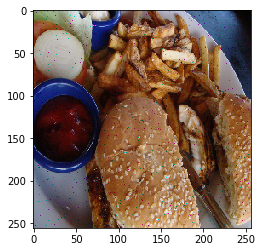

In [52]:
plt.imshow(n)
plt.show()

In [45]:
model.save("deep_autoencoder.h5")

In [46]:
from keras.models import load_model

model = load_model("deep_autoencoder.h5")

In [53]:
im = model.predict(normalise_data(np.array([n])))

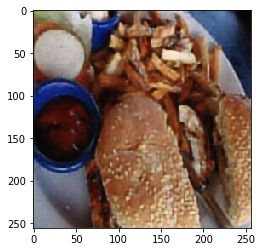

In [54]:
plt.imshow(denormalise_data(im[0]))
plt.show()

#### Looky LOOK we removed the salt and pepper noise a bit. Though the image reconstruction is blurry and you can find the original trace of the color if you look closely(for high salt and pepper percentage)

### Hopefully all these exploration would help you understand CNN architectures better. And it's always encoragable to find new ways to visualize and understand what the layer are doing. I will try activation maximisation to look what the filters are looking for?